In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc


from sklearn.model_selection import cross_val_score

from collections import Counter
from imblearn.over_sampling import SMOTE


In [2]:
ROOT = "C:/Users/Emile/Documents/Polytechnique/4A/ParisSaclay/Stage/spinal_cross_species_V1/"

## Mouse

In [3]:
# load V1 neurons
mouse_V1 = sc.read_h5ad(ROOT + "data/annotated_data/mouse_V1.h5ad")
mouse_V1

AnnData object with n_obs × n_vars = 4424 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'doublet_finder', 'percent_mito', 'keep', 'nCount_SCT', 'nFeature_SCT', 'GFP', 'RNA_snn_res.2', 'seurat_clusters', 'training_labels', 'citeseq', 'annotation', 'labels_xgb', 'v1', 'leiden'
    var: 'vf_vst_counts.BOUV5_mean', 'vf_vst_counts.BOUV5_variance', 'vf_vst_counts.BOUV5_variance.expected', 'vf_vst_counts.BOUV5_variance.standardized', 'vf_vst_counts.BOUV5_variable', 'vf_vst_counts.BOUV5_rank', 'vf_vst_counts.KATHE_mean', 'vf_vst_counts.KATHE_variance', 'vf_vst_counts.KATHE_variance.expected', 'vf_vst_counts.KATHE_variance.standardized', 'vf_vst_counts.KATHE_variable', 'vf_vst_counts.KATHE_rank', 'vf_vst_counts.MATSON_mean', 'vf_vst_counts.MATSON_variance', 'vf_vst_counts.MATSON_variance.expected', 'vf_vst_counts.MATSON_variance.standardized', 'vf_vst_counts.MATSON_variable', 'vf_vst_counts.MATSON_rank', 'vf_vst_counts.KNAF3_mean', 'vf_vst_counts.KNAF3_variance', 'vf_vs

In [4]:
mouse_V1.obs['orig.ident'].value_counts()

orig.ident
KNAF13        1935
KNAF4         1807
GSE7474501     307
GSM7474503     180
KATHE           75
MATSON          66
KNAF3           38
BOUV5           16
Name: count, dtype: int64

### Clustering

In [5]:
# Compute UMAP representation using RPCA representation
sc.neighbors.neighbors(mouse_V1, use_rep='X_rpca')
sc.tl.pca(mouse_V1)
sc.tl.umap(mouse_V1)

In [6]:
sc.tl.leiden(mouse_V1, resolution=0.1)

C:\Users\Emile\AppData\Local\Temp\ipykernel_40828\89308009.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(mouse_V1, resolution=0.1)


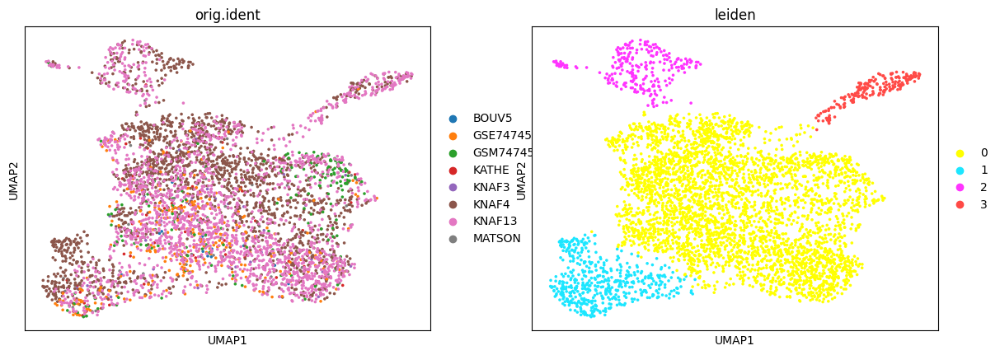

In [7]:
sc.pl.umap(mouse_V1, color = ['orig.ident', 'leiden'])

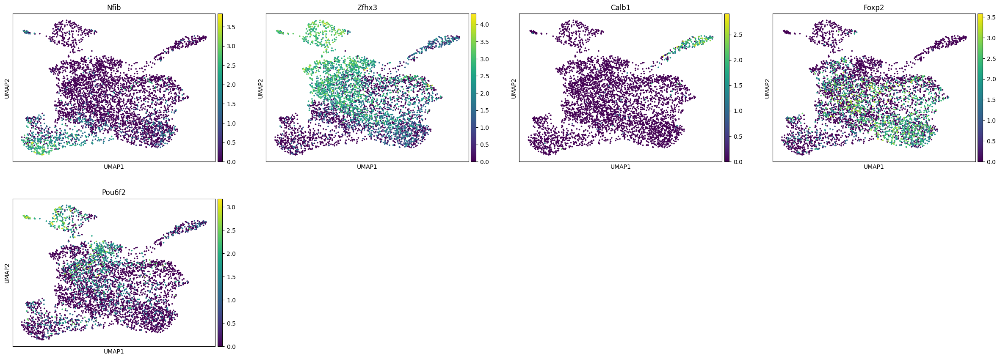

In [8]:
sc.pl.umap(mouse_V1, color = ['Nfib', 'Zfhx3', 'Calb1', 'Foxp2', 'Pou6f2'])

In [9]:
y_leiden = np.array(mouse_V1.obs['leiden'].values.astype(int))

### Feature selection MI, RFE and RF

In [10]:
# Compute 0 1 features to simulate ISH
features = np.array(mouse_V1.X>1).astype(int)
feature_names = mouse_V1.var_names
print(len(features[0]), len(feature_names))

2000 2000


In [11]:
indx = []
for i in range(len(feature_names)):
  indx.append(i)
print(len(feature_names))

2000


In [12]:
# Oversample the clusters
count = Counter(y_leiden)
print(count)
# X, y = features, y_leiden
oversample = SMOTE()
X, y = oversample.fit_resample(features, y_leiden)
count = Counter(y)
count

Counter({np.int64(0): 3462, np.int64(1): 509, np.int64(2): 257, np.int64(3): 196})


Counter({np.int64(0): 3462,
         np.int64(1): 3462,
         np.int64(2): 3462,
         np.int64(3): 3462})

In [13]:
from sklearn.svm import LinearSVC
# for data preparation and others
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import precision_recall_fscore_support

# models tried
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import RFE
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

In [14]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)

In [15]:
# Mutual information
mi = mutual_info_classif(X_train, y_train, discrete_features='auto', n_neighbors=3, copy=True, random_state=42)

In [16]:
gains = np.asarray(mi)
indexes = np.where(gains != 0)[0]
print(len(indexes))

1655


In [17]:
#training a linearSVC model with different numbers of MI features starting from the top 2 to the top 1000
#the highest accuracy corresponds to the best number of features
graph_MI = []
for i in range (2,200):
  
  it = sorted(range(len(gains)), key = lambda sub: gains[sub])[-i:]
  x_train = X_train[:, it]
  x_test = X_test[:, it]
  Y_train = y_train[:]
  Y_test = y_test[:]
  x_train = x_train.astype('float32')
  x_test = x_test.astype('float32')
  clf = LinearSVC(random_state=42)
  clf.fit(x_train, Y_train)
  scores = clf.score(x_test, Y_test)
  y_pred = clf.predict(x_test)
  graph_MI.append(scores)

Text(0, 0.5, 'Accuracy')

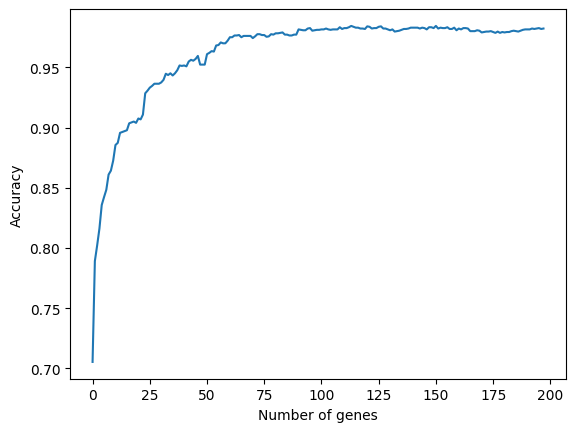

In [18]:
#Plot a graph with all accuracy scores
plt.plot(graph_MI)
plt.xlabel('Number of genes')
plt.ylabel('Accuracy')

In [19]:
#Display the best number of features
graph_MI = np.asarray(graph_MI)
print(np.argmax(graph_MI))
print(graph_MI[np.argmax(graph_MI)]) 
print(np.where(graph_MI == graph_MI[np.argmax(graph_MI)]))

113
0.9844765342960289
(array([113, 150]),)


In [20]:
it = sorted(range(len(gains)), key = lambda sub: gains[sub])[-184:]
x_train = X_train[:, it]
x_test = X_test[:, it]
Y_train = y_train[:]
Y_test = y_test[:]
x_train = x_train.astype('float32')
X_test = x_test.astype('float32')

clf = LinearSVC(random_state=42)
clf.fit(x_train, Y_train)
scores = clf.score(x_test, Y_test)
print('Score: ' + str(scores))
y_pred = clf.predict(x_test)


print(confusion_matrix(Y_test,y_pred))
print(classification_report(Y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.9794223826714802
[[666  27   3   1]
 [ 24 672   0   0]
 [  2   0 709   0]
 [  0   0   0 666]]
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       697
           1       0.96      0.97      0.96       696
           2       1.00      1.00      1.00       711
           3       1.00      1.00      1.00       666

    accuracy                           0.98      2770
   macro avg       0.98      0.98      0.98      2770
weighted avg       0.98      0.98      0.98      2770

0.9794223826714802
(np.float64(0.9793984589495202), np.float64(0.9794223826714802), np.float64(0.9794059129467567), None)


In [21]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.3, random_state=1, shuffle=True)

In [22]:
# Compute important features from a random forest estimator
regressor = RandomForestClassifier(n_estimators=100, random_state=42)
regressor.fit(X_train, y_train)
y_pred = regressor.predict(X_test)
sorted_features = sorted (zip(map(lambda x: round(x, 4), regressor.feature_importances_), indx),reverse=True)
important_f = []
  

for s in sorted_features:
  if s[0] != 0:
    important_f.append(s[1])
important_f = np.transpose(important_f)
important_f = np.asarray(important_f)

it = sorted(range(len(gains)), key = lambda sub: gains[sub])[-190:]
similarity = []
count = 0
for f in important_f:
  for t in it:
    if (f == t):
      count = count + 1
      similarity.append(f)

print(accuracy_score(y_test, y_pred))
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))
print("the number of important features used: ", len(important_f))
print ("number of similar features: ", len(similarity))

0.9790613718411553
[[1042    1    0    1]
 [  79  962    0    0]
 [   5    0 1039    0]
 [   1    0    0 1025]]
              precision    recall  f1-score   support

           0       0.92      1.00      0.96      1044
           1       1.00      0.92      0.96      1041
           2       1.00      1.00      1.00      1044
           3       1.00      1.00      1.00      1026

    accuracy                           0.98      4155
   macro avg       0.98      0.98      0.98      4155
weighted avg       0.98      0.98      0.98      4155

(np.float64(0.980548492266916), np.float64(0.9790613718411553), np.float64(0.979085480459853), None)
the number of important features used:  1044
number of similar features:  189


In [23]:
# The wrapper method (recursive feature elimination RFE)

X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)

estimator = LinearSVC(random_state=42)
selector = RFE(estimator, n_features_to_select= 10, step=5)
selector = selector.fit(X_train, y_train)

# testing the model
y_pred = selector.predict(X_test)
print(accuracy_score(y_test,y_pred))
print(selector.score(X_test, y_test))
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

print(np.count_nonzero(selector.support_ == 1))

0.8736462093862816
0.8736462093862816
[[493  72 101  31]
 [ 64 629   0   3]
 [  7   6 649  49]
 [  0   0  17 649]]
              precision    recall  f1-score   support

           0       0.87      0.71      0.78       697
           1       0.89      0.90      0.90       696
           2       0.85      0.91      0.88       711
           3       0.89      0.97      0.93       666

    accuracy                           0.87      2770
   macro avg       0.87      0.87      0.87      2770
weighted avg       0.87      0.87      0.87      2770

(np.float64(0.8738518634917151), np.float64(0.8736462093862816), np.float64(0.8706991242935076), None)
10


In [24]:
y_pred = selector.predict(features)
print(accuracy_score(y_leiden,y_pred))
print(selector.score(features, y_leiden))
print(confusion_matrix(y_leiden,y_pred))
print(classification_report(y_leiden,y_pred))
print(precision_recall_fscore_support(y_leiden, y_pred, average = 'weighted'))

0.73123869801085
0.73123869801085
[[2583  316  408  155]
 [ 241  255    4    9]
 [  30    2  218    7]
 [   7    0   10  179]]
              precision    recall  f1-score   support

           0       0.90      0.75      0.82      3462
           1       0.45      0.50      0.47       509
           2       0.34      0.85      0.49       257
           3       0.51      0.91      0.66       196

    accuracy                           0.73      4424
   macro avg       0.55      0.75      0.61      4424
weighted avg       0.80      0.73      0.75      4424

(np.float64(0.8001583380495327), np.float64(0.73123869801085), np.float64(0.7508729518636034), None)


In [25]:
#Create a list with indices of RFE Features
RFE_features = np.where(selector.support_ == 1)
RFE_features = np.asarray(RFE_features)
rfe_f = []
for i in RFE_features:
  for s in i:
    rfe_f.append(s)
rfe_f = np.asarray(rfe_f)
rfe_f

array([ 257,  376,  467,  849,  856, 1116, 1242, 1265, 1363, 1857])

In [26]:
rfe_f_names = []
for i in rfe_f:
    rfe_f_names.append(feature_names[i])
rfe_f_names

['Gm14418',
 'Calb1',
 'Lhfpl3',
 'Zfhx3',
 'Maf',
 'Shisa6',
 'Adarb2',
 'Adamts16',
 'Gpc5',
 'Gm49678']

In [27]:
#Create list with common features among techniques
similar_all = []
similar_rfe_RF = []
similar_rfe_MI = []
similar_rf_MI = []

count = 0
for f in it:
  for t in rfe_f:
    if (f == t):
      count = count + 1
      similar_rfe_MI.append(f)
print("number of similar features between RFE and MI: ", count)

count = 0
for f in important_f:
  for t in rfe_f:
    if (f == t):
      count = count + 1
      similar_rfe_RF.append(f)
print("number of similar features between RFE and RF: ", count)

count = 0
for f in similarity:
  for t in rfe_f:
    if (f == t):
      count = count + 1
      similar_all.append(f)
print("number of similar features between RF and MI: ", len(similarity))
print("number of similar features between RFE, RF and MI: ", count)

number of similar features between RFE and MI:  6
number of similar features between RFE and RF:  8
number of similar features between RF and MI:  189
number of similar features between RFE, RF and MI:  6


In [28]:
similarity
rfm_f_names= []
for i in similarity:
    rfm_f_names.append(feature_names[i])

In [29]:
rfm_f_names

['Adarb2',
 'Nrg1',
 'Zfhx3',
 'Col25a1',
 'Frmpd4',
 'Stk32a',
 'Pde4d',
 'Kcnq5',
 'Calb1',
 'Rgs6',
 'Erbb4',
 'Nxph1',
 'Il1rapl2',
 'Sgcz',
 'Meis2',
 'Chrm2',
 'Dcc',
 'Zfp804b',
 'Tenm2',
 'Hs3st5',
 'Esrrg',
 'Stxbp6',
 'Galntl6',
 'Col5a2',
 'Ptprd',
 'B3galt1',
 'Pacrg',
 'Adamtsl1',
 'Nfib',
 'Cacna2d3',
 'Myo5b',
 'Samd5',
 'Bmpr1b',
 'Pcdh11x',
 'Edil3',
 'Cdh4',
 'Foxp2',
 '6330411D24Rik',
 'Zfp385b',
 'A830018L16Rik',
 'Slit2',
 'Gm20754',
 'Stk32b',
 'Sorcs1',
 'Galnt14',
 'Lrmda',
 'C130073E24Rik',
 'Npas3',
 'Mast4',
 'Dgkb',
 'Zfhx4',
 'Utrn',
 'Lhfpl3',
 'Cdh6',
 'Pou6f2',
 'Nkain3',
 'Pld5',
 'Grm1',
 'Rnf207',
 'Plcl1',
 'Plce1',
 'St3gal1',
 'Tcf4',
 'Sgcd',
 'Cdh9',
 'Tle4',
 'Olfm3',
 'Etl4',
 'Hs6st3',
 'Ptprt',
 'Xylt1',
 '9630014M24Rik',
 'Myo16',
 'Chrna7',
 'Sdk1',
 'Adamts16',
 'Crim1',
 'Trhr',
 'Slit3',
 'Bcan',
 'Opcml',
 'Nell1',
 'Trpc3',
 'Gm10649',
 'Htr4',
 'Bmper',
 'March11',
 'Pdzrn4',
 'Slc35f3',
 'Mitf',
 'Lgi2',
 'Nxph2',
 'Gm26871',
 'Grip1

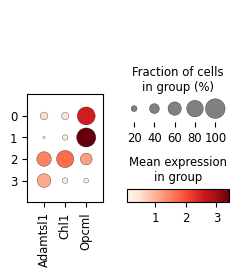

In [30]:
sc.pl.dotplot(mouse_V1, var_names=['Adamtsl1', 'Chl1', 'Opcml'], groupby='leiden', expression_cutoff=1)

In [31]:
rfe_f_names = []
for i in rfe_f:
    rfe_f_names.append(feature_names[i])

In [32]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)
X_train = X_train[:, similar_all]
X_test = X_test[:, similar_all]
Y_train = y_train[:]
Y_test = y_test[:]
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
Y_train = Y_train[:]
Y_test = Y_test[:]
clf = LinearSVC(random_state=42)

clf.fit(X_train, Y_train)
print('Score: ' + str(clf.score(X_test, Y_test)))
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.8527075812274368
[[431  94 131  41]
 [ 61 631   0   4]
 [  5   6 651  49]
 [  0   0  17 649]]
              precision    recall  f1-score   support

           0       0.87      0.62      0.72       697
           1       0.86      0.91      0.88       696
           2       0.81      0.92      0.86       711
           3       0.87      0.97      0.92       666

    accuracy                           0.85      2770
   macro avg       0.85      0.85      0.85      2770
weighted avg       0.85      0.85      0.85      2770

0.8527075812274368
(np.float64(0.8542493029548541), np.float64(0.8527075812274368), np.float64(0.8466829277843013), None)


In [33]:
similar_all

[np.int64(1242),
 np.int64(849),
 np.int64(376),
 np.int64(467),
 np.int64(1265),
 np.int64(1116)]

In [34]:
#Save in a Data Frame
similar_all_names = []
for i in similar_all:
  similar_all_names.append(feature_names[i])
similar_all_names

['Adarb2', 'Zfhx3', 'Calb1', 'Lhfpl3', 'Adamts16', 'Shisa6']

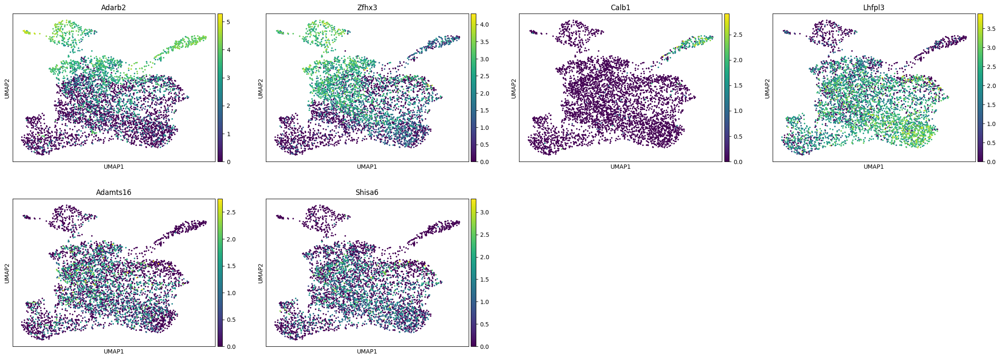

In [35]:
sc.pl.umap(mouse_V1, color = similar_all_names)

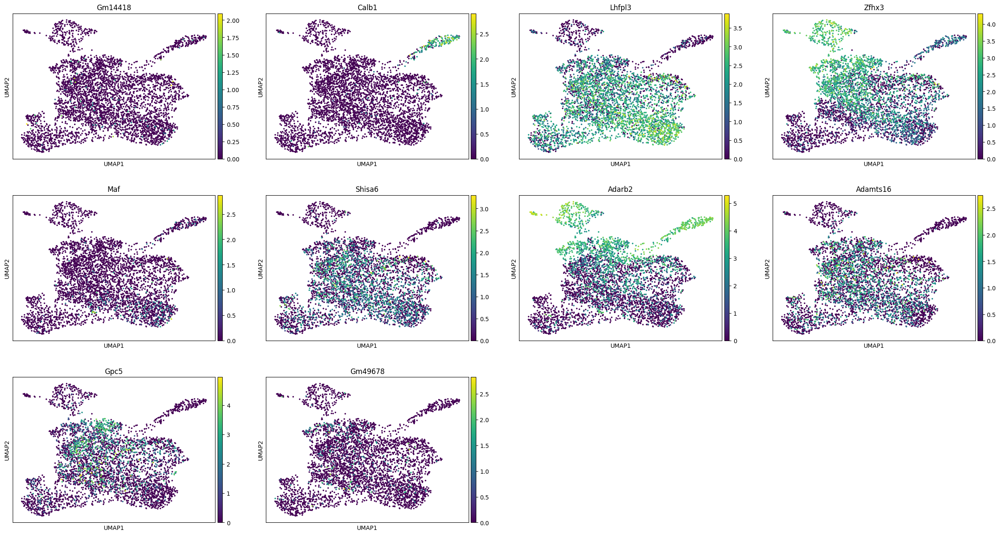

In [36]:
sc.pl.umap(mouse_V1, color = rfe_f_names, vmin=0)

In [37]:
cross_val_score(clf, features[:,similar_all], y_leiden)

array([0.82033898, 0.82259887, 0.80677966, 0.81355932, 0.81447964])

In [38]:
markers = ['ADARB2',
 'ZFHX3',
 'NFIB',
 'CALB1',
 'KCNQ5',
 'MEIS2',
 'TCF4',
 'SAMD5',
 'ST18',
 'STK32B',
 'MOBP'
]

In [39]:
markers = ['Calb1', 'Stk32b', 'Zfhx3', 'Adarb2', 'Nfib', 'Tcf4', 'Pou6f2', 'Foxp2', 'Kcnq5'] +[ 'Opcml'] # 'Adamtsl1', 'Chl1',

In [40]:
marker_idx = []
for m in markers:
    marker_idx.append(list(feature_names).index(m))

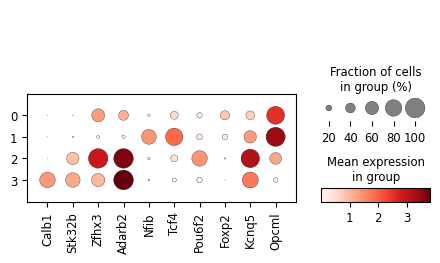

In [41]:
sc.pl.dotplot(mouse_V1, var_names=markers, groupby='leiden', expression_cutoff=1)

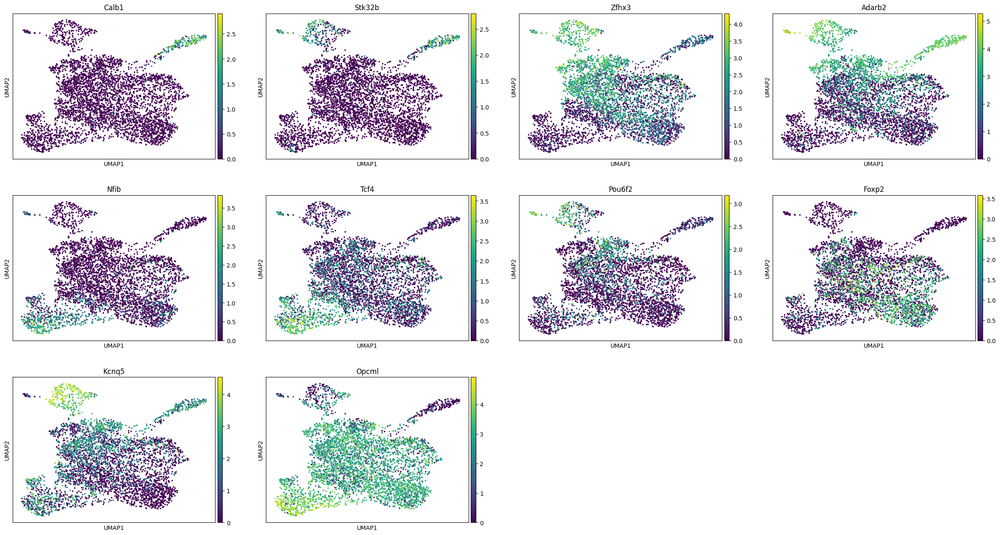

In [42]:
sc.pl.umap(mouse_V1, color = markers)

In [43]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)
X_train = X_train[:, marker_idx]
X_test = X_test[:, marker_idx]
Y_train = y_train[:]
Y_test = y_test[:]
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
Y_train = Y_train[:]
Y_test = Y_test[:]
clf = SVC(random_state=1, probability = True)

clf.fit(X_train, Y_train)
print('Score: ' + str(clf.score(X_test, Y_test)))
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.8700361010830325
[[456 160  43  38]
 [ 25 670   1   0]
 [ 30   7 630  44]
 [  6   0   6 654]]
              precision    recall  f1-score   support

           0       0.88      0.65      0.75       697
           1       0.80      0.96      0.87       696
           2       0.93      0.89      0.91       711
           3       0.89      0.98      0.93       666

    accuracy                           0.87      2770
   macro avg       0.87      0.87      0.87      2770
weighted avg       0.87      0.87      0.87      2770

0.8700361010830325
(np.float64(0.8745177641664558), np.float64(0.8700361010830325), np.float64(0.8654779216404093), None)


In [44]:
cross_val_score(clf, features[:, marker_idx], y_leiden)

array([0.88926554, 0.89491525, 0.87909605, 0.91751412, 0.90497738])

In [45]:
clf.predict_proba(features[:2, marker_idx])

array([[9.40817787e-02, 2.75410131e-03, 6.97107290e-02, 8.33453391e-01],
       [1.75095276e-01, 8.20106632e-01, 4.54971092e-03, 2.48380846e-04]])

In [46]:
from sklearn.metrics import cohen_kappa_score
cohen_kappa_score(y_test, y_pred)

np.float64(0.8267650138290925)

In [47]:
mouse_V1.obs['predicted_clusters_with_markers'] = clf.predict(features[:, marker_idx])
mouse_V1.obs['predicted_clusters_with_markers'] = mouse_V1.obs['predicted_clusters_with_markers'].astype('category')

In [48]:
mouse_V1.uns['predicted_clusters_with_markers_colors'] = mouse_V1.uns['leiden_colors']

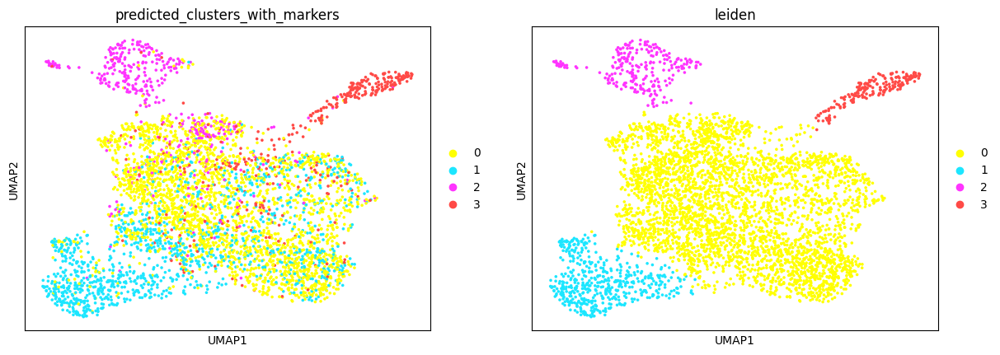

In [49]:
sc.pl.umap(mouse_V1, color = ['predicted_clusters_with_markers', 'leiden'])

In [50]:
probas = clf.predict_proba(features[:, marker_idx])

In [51]:
np.shape(probas)

(4424, 4)

In [52]:
for i, c in enumerate(mouse_V1.obs['leiden'].cat.categories):
    print(i,c)
    mouse_V1.obs['probas_cluster_'+c] = probas[:,i]

0 0
1 1
2 2
3 3


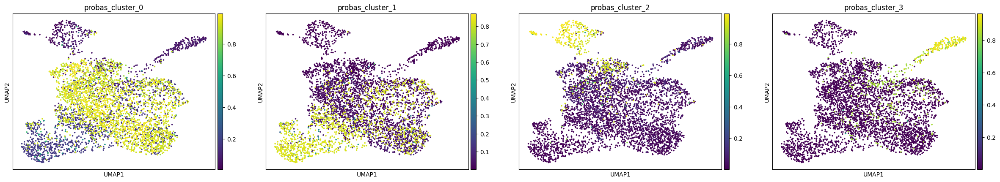

In [53]:
sc.pl.umap(mouse_V1, color = ['probas_cluster_0', 'probas_cluster_1', 'probas_cluster_2', 'probas_cluster_3'])

## Human

In [54]:
cross_species = sc.read_h5ad(ROOT + "data/annotated_data/cross_species_all_sets_common_genes_final.h5ad")

In [55]:
human_V1 = cross_species[cross_species.obs['species'] == 'human']
human_V1 = human_V1[human_V1.obs['predicted_annotation'] == 'V1_predicted']
del cross_species
human_V1

View of AnnData object with n_obs × n_vars = 747 × 2000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'species', 'doublet_finder', 'percent_mito', 'keep', 'RNA_snn_res.2', 'seurat_clusters', 'training_labels', 'annotation', 'predicted_labels_xgb', 'predicted_annotation'
    var: 'vf_vst_counts.BOUV5_mean', 'vf_vst_counts.BOUV5_variance', 'vf_vst_counts.BOUV5_variance.expected', 'vf_vst_counts.BOUV5_variance.standardized', 'vf_vst_counts.BOUV5_variable', 'vf_vst_counts.BOUV5_rank', 'vf_vst_counts.KATHE_mean', 'vf_vst_counts.KATHE_variance', 'vf_vst_counts.KATHE_variance.expected', 'vf_vst_counts.KATHE_variance.standardized', 'vf_vst_counts.KATHE_variable', 'vf_vst_counts.KATHE_rank', 'vf_vst_counts.MATSON_mean', 'vf_vst_counts.MATSON_variance', 'vf_vst_counts.MATSON_variance.expected', 'vf_vst_counts.MATSON_variance.standardized', 'vf_vst_counts.MATSON_variable', 'vf_vst_counts.MATSON_rank', 'vf_vst_counts.KNAF3_mean', 'vf_vst_counts.KNAF3_variance', 'vf_vst_counts.KNAF3_variance

### Clustering

In [56]:
# Compute UMAP representation using RPCA representation
sc.neighbors.neighbors(human_V1, use_rep='X_rpca')
sc.tl.pca(human_V1)
sc.tl.umap(human_V1)

In [57]:
sc.tl.leiden(human_V1, resolution=0.16)

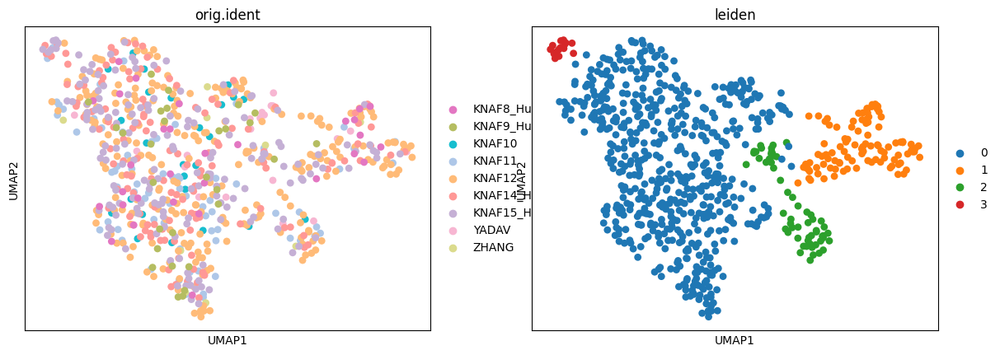

In [58]:
sc.pl.umap(human_V1, color = ['orig.ident', 'leiden'])

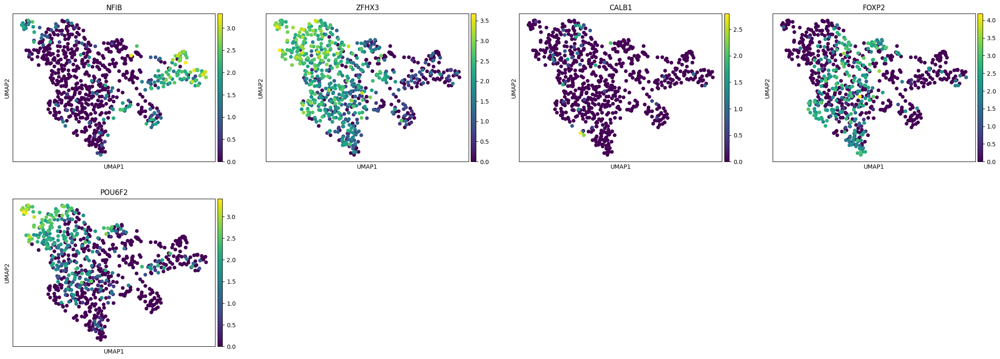

In [59]:
sc.pl.umap(human_V1, color = ['NFIB', 'ZFHX3', 'CALB1', 'FOXP2', 'POU6F2'])

In [60]:
y_leiden = np.array(human_V1.obs['leiden'].values.astype(int))

### Feature selection MI, RFE and RF

In [61]:
features = np.array(human_V1.X>1).astype(int)
feature_names = human_V1.var_names
print(len(features[0]), len(feature_names))

2000 2000


In [62]:
indx = []
for i in range(len(feature_names)):
  indx.append(i)
print(len(feature_names))

2000


In [63]:
count = Counter(y_leiden)
print(count)
# X, y = features, y_leiden
oversample = SMOTE()
X, y = oversample.fit_resample(features, y_leiden)
count = Counter(y)
count

Counter({np.int64(0): 572, np.int64(1): 102, np.int64(2): 58, np.int64(3): 15})


Counter({np.int64(0): 572,
         np.int64(2): 572,
         np.int64(1): 572,
         np.int64(3): 572})

In [64]:
from sklearn.svm import LinearSVC
from sklearn import svm
# for data preparation and others
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import precision_recall_fscore_support
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

# models tried
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import RFE
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

In [65]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)

In [66]:
mi = mutual_info_classif(X_train, y_train, discrete_features='auto', n_neighbors=3, copy=True, random_state=42)

In [67]:
gains = np.asarray(mi)
indexes = np.where(gains != 0)[0]
print(len(indexes))

1605


In [68]:
#training a linearSVC model with different numbers of MI features starting from the top 2 to the top 1000
#the highest accuracy corresponds to the best number of features
graph_MI = []
for i in range (2,200):
  
  it = sorted(range(len(gains)), key = lambda sub: gains[sub])[-i:]
  x_train = X_train[:, it]
  x_test = X_test[:, it]
  Y_train = y_train[:]
  Y_test = y_test[:]
  x_train = x_train.astype('float32')
  x_test = x_test.astype('float32')
  clf = LinearSVC(random_state=42)
  clf.fit(x_train, Y_train)
  scores = clf.score(x_test, Y_test)
  y_pred = clf.predict(x_test)
  graph_MI.append(scores)

Text(0, 0.5, 'Accuracy')

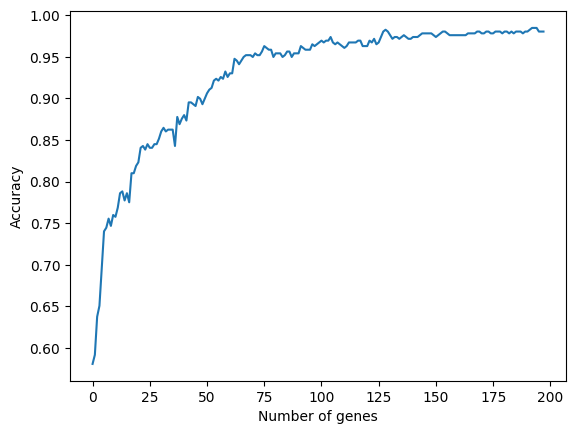

In [69]:
#Plot a graph with all accuracy scores
plt.plot(graph_MI)
plt.xlabel('Number of genes')
plt.ylabel('Accuracy')

In [70]:
#Display the best number of features
graph_MI = np.asarray(graph_MI)
print(np.argmax(graph_MI))
print(graph_MI[np.argmax(graph_MI)]) 
print(np.where(graph_MI == graph_MI[np.argmax(graph_MI)]))

192
0.9847161572052402
(array([192, 193, 194]),)


In [71]:

it = sorted(range(len(gains)), key = lambda sub: gains[sub])[-25:]
x_train = X_train[:, it]
x_test = X_test[:, it]
Y_train = y_train[:]
Y_test = y_test[:]
x_train = x_train.astype('float32')
X_test = x_test.astype('float32')

clf = LinearSVC(random_state=42)
clf.fit(x_train, Y_train)
scores = clf.score(x_test, Y_test)
print('Score: ' + str(scores))
y_pred = clf.predict(x_test)


print(confusion_matrix(Y_test,y_pred))
print(classification_report(Y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.8384279475982532
[[ 83  15   9   0]
 [  7  82  38   0]
 [  2   3 109   0]
 [  0   0   0 110]]
              precision    recall  f1-score   support

           0       0.90      0.78      0.83       107
           1       0.82      0.65      0.72       127
           2       0.70      0.96      0.81       114
           3       1.00      1.00      1.00       110

    accuracy                           0.84       458
   macro avg       0.86      0.84      0.84       458
weighted avg       0.85      0.84      0.84       458

0.8384279475982532
(np.float64(0.8522411677936644), np.float64(0.8384279475982532), np.float64(0.8363625105158019), None)


In [72]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.3, random_state=1, shuffle=True)

In [73]:
regressor = RandomForestClassifier(n_estimators=100, random_state=42)
regressor.fit(X_train, y_train)
y_pred = regressor.predict(X_test)
sorted_features = sorted (zip(map(lambda x: round(x, 4), regressor.feature_importances_), indx),reverse=True)
important_f = []
  

for s in sorted_features:
  if s[0] != 0:
    important_f.append(s[1])
important_f = np.transpose(important_f)
important_f = np.asarray(important_f)

it = sorted(range(len(gains)), key = lambda sub: gains[sub])[-126:]
similarity = []
count = 0
for f in important_f:
  for t in it:
    if (f == t):
      count = count + 1
      similarity.append(f)

print(accuracy_score(y_test, y_pred))
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))
print("the number of important features used: ", len(important_f))
print ("number of similar features: ", len(similarity))

0.9767103347889374
[[161   3   0   0]
 [ 10 172   0   0]
 [  3   0 174   0]
 [  0   0   0 164]]
              precision    recall  f1-score   support

           0       0.93      0.98      0.95       164
           1       0.98      0.95      0.96       182
           2       1.00      0.98      0.99       177
           3       1.00      1.00      1.00       164

    accuracy                           0.98       687
   macro avg       0.98      0.98      0.98       687
weighted avg       0.98      0.98      0.98       687

(np.float64(0.9776231825862906), np.float64(0.9767103347889374), np.float64(0.9768506767064336), None)
the number of important features used:  1257
number of similar features:  126


In [74]:
graph_RFE = []
for i in range(1, 50, 2):
  estimator = LinearSVC(random_state=42)
  selector = RFE(estimator, n_features_to_select= i, step=0.5)
  selector = selector.fit(X_train, y_train)
  # testing the model
  y_pred = selector.predict(X_test)
  graph_RFE.append(selector.score(X_test, y_test))

Text(0, 0.5, 'Accuracy')

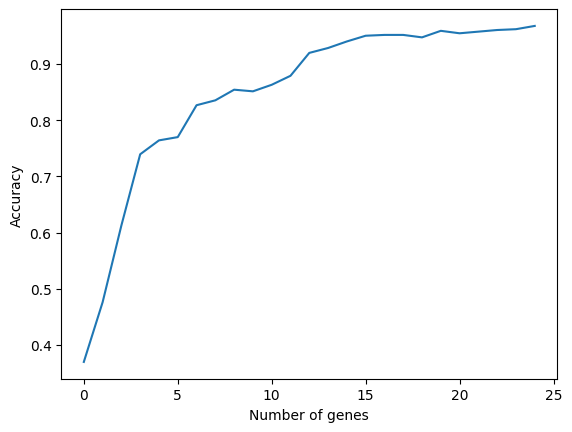

In [75]:
#Plot a graph with all accuracy scores
plt.plot(graph_RFE)
plt.xlabel('Number of genes')
plt.ylabel('Accuracy')

In [76]:
#Display the best number of features
graph_RFE = np.asarray(graph_RFE)
print(np.argmax(graph_RFE))
print(graph_RFE[np.argmax(graph_RFE)])
print(np.count_nonzero(np.where(graph_RFE == graph_RFE[np.argmax(graph_RFE)])))
print(np.where(graph_RFE == graph_RFE[np.argmax(graph_RFE)]))

24
0.9679767103347889
1
(array([24]),)


In [77]:
#The wrapper method (recursive feature elimination RFE)

X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)

estimator = LinearSVC(random_state=42)
selector = RFE(estimator, n_features_to_select= 24, step=0.1)
selector = selector.fit(X_train, y_train)

# testing the model
y_pred = selector.predict(X_test)
print(accuracy_score(y_test,y_pred))
print(selector.score(X_test, y_test))
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

print(np.count_nonzero(selector.support_ == 1))

c:\Users\Emile\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


0.9410480349344978
0.9410480349344978
[[ 93   3   7   4]
 [  2 119   6   0]
 [  4   0 110   0]
 [  1   0   0 109]]
              precision    recall  f1-score   support

           0       0.93      0.87      0.90       107
           1       0.98      0.94      0.96       127
           2       0.89      0.96      0.93       114
           3       0.96      0.99      0.98       110

    accuracy                           0.94       458
   macro avg       0.94      0.94      0.94       458
weighted avg       0.94      0.94      0.94       458

(np.float64(0.9420184790017216), np.float64(0.9410480349344978), np.float64(0.9408098315857767), None)
24


In [78]:
y_pred = selector.predict(features)
print(accuracy_score(y_leiden,y_pred))
print(selector.score(features, y_leiden))
print(confusion_matrix(y_leiden,y_pred))
print(classification_report(y_leiden,y_pred))
print(precision_recall_fscore_support(y_leiden, y_pred, average = 'weighted'))

0.8955823293172691
0.8955823293172691
[[514  17  29  12]
 [  6  95   1   0]
 [  8   2  48   0]
 [  3   0   0  12]]
              precision    recall  f1-score   support

           0       0.97      0.90      0.93       572
           1       0.83      0.93      0.88       102
           2       0.62      0.83      0.71        58
           3       0.50      0.80      0.62        15

    accuracy                           0.90       747
   macro avg       0.73      0.86      0.78       747
weighted avg       0.91      0.90      0.90       747

(np.float64(0.912824216853895), np.float64(0.8955823293172691), np.float64(0.9009374059789578), None)


In [79]:
#Create a list with indices of RFE Features
RFE_features = np.where(selector.support_ == 1)
RFE_features = np.asarray(RFE_features)
rfe_f = []
for i in RFE_features:
  for s in i:
    rfe_f.append(s)
rfe_f = np.asarray(rfe_f)
rfe_f

array([   4,  231,  238,  406,  444,  451,  630,  641,  655,  713,  756,
        873,  905, 1044, 1060, 1150, 1185, 1302, 1462, 1507, 1707, 1762,
       1789, 1828])

In [80]:
rfe_f_names = []
for i in rfe_f:
    rfe_f_names.append(feature_names[i])
rfe_f_names

['SNTG1',
 'MPPED2',
 'MEIS2',
 'CHD7',
 'NFIB',
 'ELAVL2',
 'FOXP2',
 'GRM8',
 'CREB5',
 'RERG',
 'ZNF536',
 'PSD3',
 'ZFHX3',
 'GRM1',
 'SAMD3',
 'UQCR10',
 'FSTL4',
 'ESRRB',
 'PCDH9',
 'ZFPM2',
 'ZNF521',
 'SALL3',
 'PIP5K1B',
 'GRIA3']

In [81]:
#Create list with common features among techniques
similar_all = []
similar_rfe_RF = []
similar_rfe_MI = []
similar_rf_MI = []

count = 0
for f in it:
  for t in rfe_f:
    if (f == t):
      count = count + 1
      similar_rfe_MI.append(f)
print("number of similar features between RFE and MI: ", count)

count = 0
for f in important_f:
  for t in rfe_f:
    if (f == t):
      count = count + 1
      similar_rfe_RF.append(f)
print("number of similar features between RFE and RF: ", count)

count = 0
for f in similarity:
  for t in rfe_f:
    if (f == t):
      count = count + 1
      similar_all.append(f)
print("number of similar features between RF and MI: ", len(similarity))
print("number of similar features between RFE, RF and MI: ", count)

number of similar features between RFE and MI:  8
number of similar features between RFE and RF:  24
number of similar features between RF and MI:  126
number of similar features between RFE, RF and MI:  8


In [82]:
similarity
rfm_f_names= []
for i in similarity:
    rfm_f_names.append(feature_names[i])

In [83]:
rfm_f_names

['KCNQ5',
 'SORCS3',
 'STK32B',
 'FSTL5',
 'NFIA',
 'ZFHX3',
 'NFIB',
 'MEIS2',
 'ITGA9',
 'SNTG1',
 'ZNF804A',
 'ATRNL1',
 'ADARB2',
 'SAMD5',
 'COL12A1',
 'C8orf34',
 'ANGPT1',
 'COL25A1',
 'GRIP1',
 'ZFHX4',
 'CACNA2D3',
 'LRMDA',
 'KLHL1',
 'FOXP2',
 'EPHA7',
 'POU6F2',
 'FSTL4',
 'ERBB4',
 'FBN2',
 'PTPRO',
 'SPON1',
 'CDH12',
 'ONECUT1',
 'GPR139',
 'ELAVL4',
 'MAMDC2',
 'NKAIN3',
 'GNA14',
 'TCF4',
 'AFF1',
 'OLFM3',
 'PDZRN4',
 'RUNX2',
 'SASH1',
 'COL11A1',
 'RALYL',
 'NXPH2',
 'INPP4B',
 'DMD',
 'NRXN3',
 'SV2B',
 'SORCS2',
 'RRAS2',
 'DYSF',
 'SDK1',
 'KIAA1217',
 'NELL2',
 'RERG',
 'THSD7B',
 'LSS',
 'GPAT3',
 'KCNC2',
 'SOX5',
 'FGF10',
 'CNTNAP4',
 'DAB1',
 'CDH4',
 'PREX2',
 'SAT1',
 'DACH1',
 'NPAS3',
 'NELL1',
 'CDK6',
 'LYPD6B',
 'PBX3',
 'ADRA1A',
 'NOVA1',
 'KCNH5',
 'GUCY1A2',
 'SULF1',
 'PAK1',
 'GREB1L',
 'STXBP6',
 'ITPR2',
 'NDST3',
 'TOX2',
 'COL19A1',
 'PLCL1',
 'PLCE1',
 'KCNS3',
 'SLIT3',
 'SLC27A6',
 'SH3RF3',
 'PIP5K1B',
 'MCC',
 'MEGF11',
 'ANTXR1',
 'TA

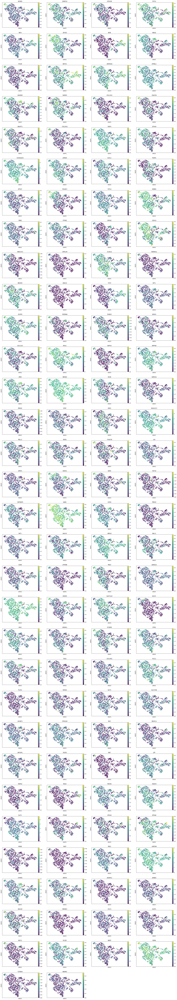

In [84]:
sc.pl.umap(human_V1, color = rfm_f_names, size = 100)

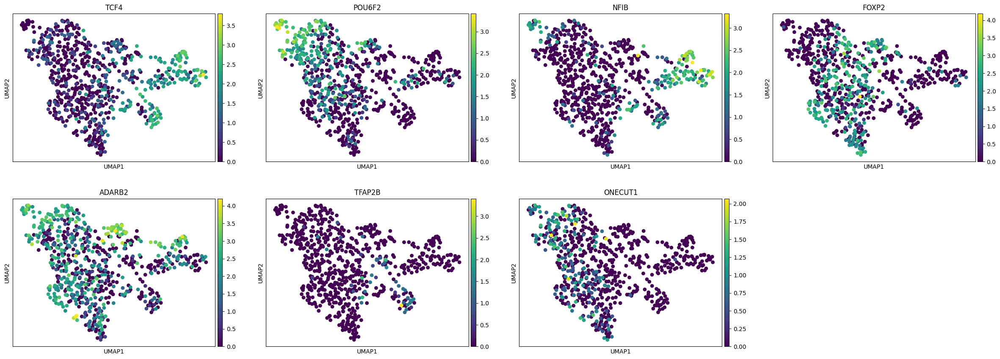

In [85]:
sc.pl.umap(human_V1, color = ['TCF4', 'POU6F2', 'NFIB', 'FOXP2', 'ADARB2', 'TFAP2B', 'ONECUT1'])

In [86]:
rfe_f_names = []
for i in rfe_f:
    rfe_f_names.append(feature_names[i])

In [87]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)
X_train = X_train[:, similar_all]
X_test = X_test[:, similar_all]
Y_train = y_train[:]
Y_test = y_test[:]
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
Y_train = Y_train[:]
Y_test = Y_test[:]
clf = LinearSVC(random_state=42)

clf.fit(X_train, Y_train)
print('Score: ' + str(clf.score(X_test, Y_test)))
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.8602620087336245
[[ 78   5  12  12]
 [  2 102  23   0]
 [  3   2 109   0]
 [  5   0   0 105]]
              precision    recall  f1-score   support

           0       0.89      0.73      0.80       107
           1       0.94      0.80      0.86       127
           2       0.76      0.96      0.84       114
           3       0.90      0.95      0.93       110

    accuracy                           0.86       458
   macro avg       0.87      0.86      0.86       458
weighted avg       0.87      0.86      0.86       458

0.8602620087336245
(np.float64(0.8705121422986292), np.float64(0.8602620087336245), np.float64(0.85909903264136), None)


In [88]:
similar_all

[np.int64(905),
 np.int64(444),
 np.int64(238),
 np.int64(4),
 np.int64(630),
 np.int64(1185),
 np.int64(713),
 np.int64(1789)]

In [89]:
#Save in a Data Frame
similar_all_names = []
for i in similar_all:
  similar_all_names.append(feature_names[i])
similar_all_names

['ZFHX3', 'NFIB', 'MEIS2', 'SNTG1', 'FOXP2', 'FSTL4', 'RERG', 'PIP5K1B']

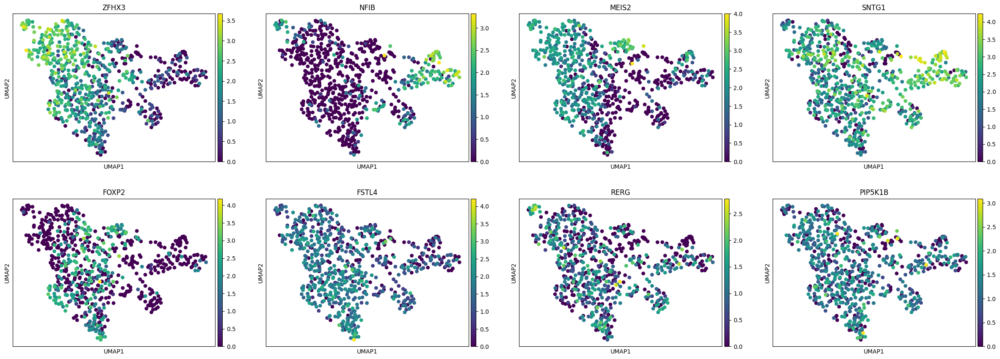

In [90]:
sc.pl.umap(human_V1, color = similar_all_names)

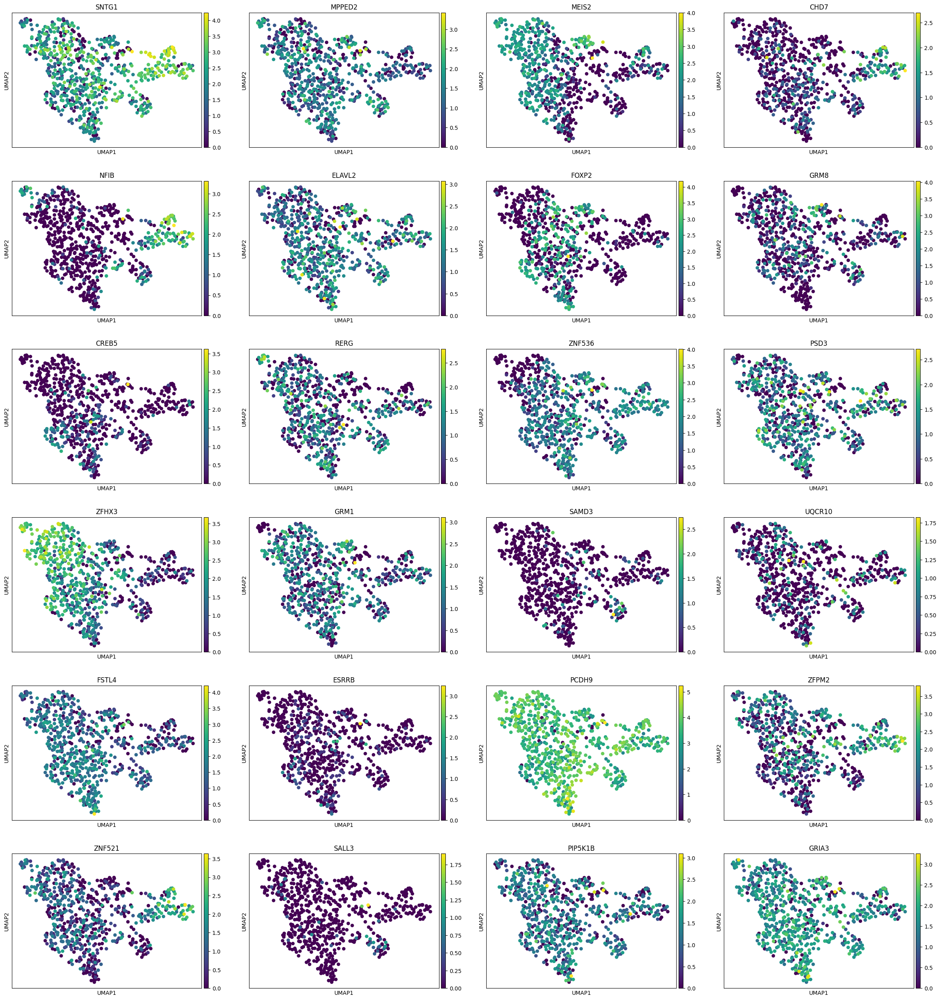

In [91]:
sc.pl.umap(human_V1, color = rfe_f_names, vmin=0)

In [92]:
sc.tl.rank_genes_groups(human_V1, groupby='leiden')
sc.tl.dendrogram(human_V1, groupby='leiden')

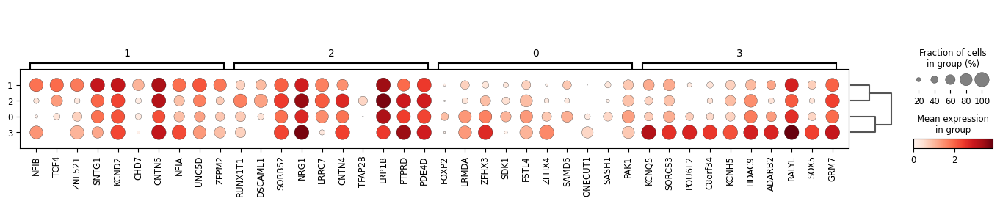

In [93]:
sc.pl.rank_genes_groups_dotplot(human_V1)

In [94]:
# markers = ['TCF4', 'POU6F2', 'NFIB', 'FOXP2', 'ADARB2', 'TFAP2B', 'CHD7', 'RUNX1T1', 'MEIS2', 'ZFHX3'] # 'ONECUT1' 'DSCAML1''ZNF521', 'BCL11A'
# markers = ['NFIB', 'SAMD5', 'ZFHX3', 'SNTG1', 'TFAP2B', 'CUX2', 'ADARB2', 'SDK1', 'KLHL1', 'SLC35F3'] #  'TGFA'
# markers = ['NFIB', 'SNTG1', 'ZFHX3', 'TFAP2B', 'KLHL1', 'SDK1']
markers = similar_all_names
print(markers)

['ZFHX3', 'NFIB', 'MEIS2', 'SNTG1', 'FOXP2', 'FSTL4', 'RERG', 'PIP5K1B']


In [95]:
marker_idx = []
for m in markers:
    marker_idx.append(list(feature_names).index(m))

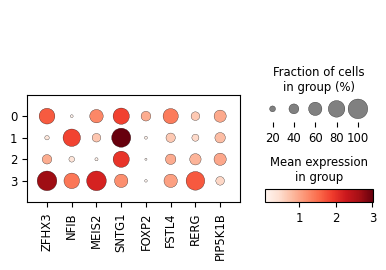

In [96]:
sc.pl.dotplot(human_V1, var_names=markers, groupby='leiden', expression_cutoff=1)

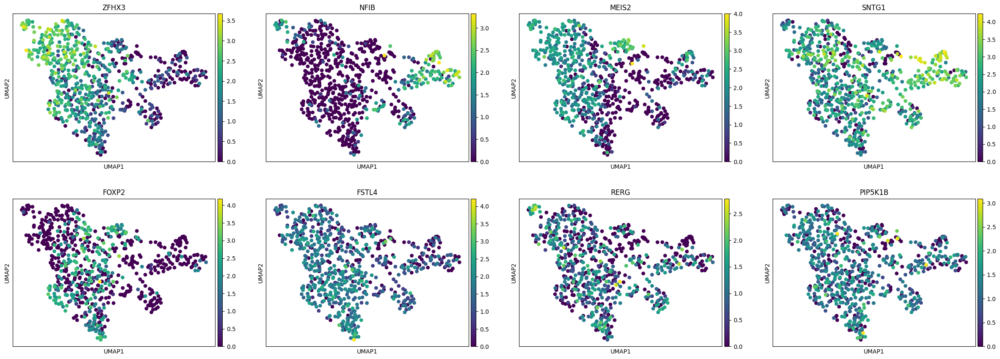

In [97]:
sc.pl.umap(human_V1, color = markers)

In [98]:
X_train, X_test, y_train , y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=True)
X_train = X_train[:, marker_idx]
X_test = X_test[:, marker_idx]
Y_train = y_train[:]
Y_test = y_test[:]
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
Y_train = Y_train[:]
Y_test = Y_test[:]
clf = SVC(random_state=1, probability = True)

clf.fit(X_train, Y_train)
print('Score: ' + str(clf.score(X_test, Y_test)))
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.87117903930131
[[ 78   3  12  14]
 [  1 102  24   0]
 [  4   0 110   0]
 [  1   0   0 109]]
              precision    recall  f1-score   support

           0       0.93      0.73      0.82       107
           1       0.97      0.80      0.88       127
           2       0.75      0.96      0.85       114
           3       0.89      0.99      0.94       110

    accuracy                           0.87       458
   macro avg       0.88      0.87      0.87       458
weighted avg       0.89      0.87      0.87       458

0.87117903930131
(np.float64(0.8866782907952478), np.float64(0.87117903930131), np.float64(0.8699674177889352), None)


In [99]:
X_train, X_test, y_train , y_test = train_test_split(features, y_leiden, test_size=0.2, random_state=1, shuffle=True)
X_train = X_train[:, marker_idx]
X_test = X_test[:, marker_idx]
Y_train = y_train[:]
Y_test = y_test[:]
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
Y_train = Y_train[:]
Y_test = Y_test[:]
clf = SVC(random_state=1, probability = True)

clf.fit(X_train, Y_train)
print('Score: ' + str(clf.score(X_test, Y_test)))
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))
print(precision_recall_fscore_support(y_test, y_pred, average = 'weighted'))

Score: 0.8533333333333334
[[104   7   2   0]
 [  2  18   1   0]
 [  8   1   4   0]
 [  1   0   0   2]]
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       113
           1       0.69      0.86      0.77        21
           2       0.57      0.31      0.40        13
           3       1.00      0.67      0.80         3

    accuracy                           0.85       150
   macro avg       0.79      0.69      0.72       150
weighted avg       0.85      0.85      0.85       150

0.8533333333333334
(np.float64(0.847722248765727), np.float64(0.8533333333333334), np.float64(0.8451521712081622), None)


In [100]:
cross_val_score(clf, features[:, marker_idx], y_leiden)

array([0.86666667, 0.81333333, 0.89932886, 0.87919463, 0.8590604 ])

In [101]:
clf.predict_proba(features[:2, marker_idx])

array([[0.93904974, 0.01698421, 0.02750874, 0.01645732],
       [0.86732345, 0.04448803, 0.08565038, 0.00253814]])

In [102]:
from sklearn.metrics import cohen_kappa_score
cohen_kappa_score(y_test, y_pred)

np.float64(0.6276235612728505)

In [103]:
human_V1.obs['predicted_clusters_with_markers'] = clf.predict(features[:, marker_idx])
human_V1.obs['predicted_clusters_with_markers'] = human_V1.obs['predicted_clusters_with_markers'].astype('category')

In [104]:
human_V1.uns['predicted_clusters_with_markers_colors'] = human_V1.uns['leiden_colors']

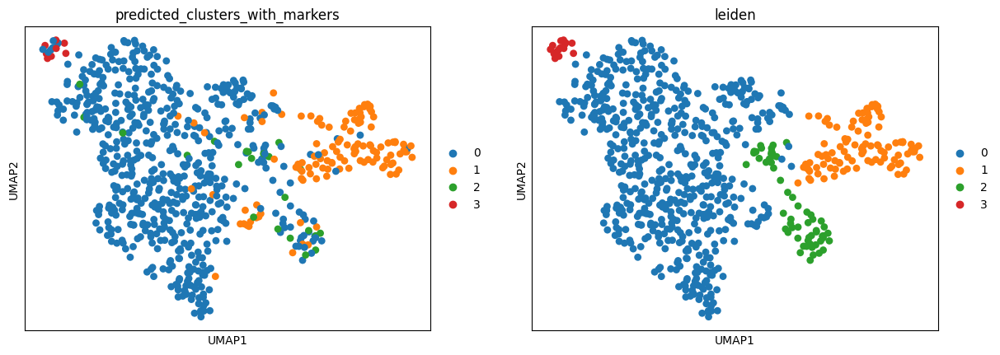

In [105]:
sc.pl.umap(human_V1, color = ['predicted_clusters_with_markers', 'leiden'])

In [106]:
probas = clf.predict_proba(features[:, marker_idx])

In [107]:
np.shape(probas)

(747, 4)

In [108]:
for i, c in enumerate(human_V1.obs['leiden'].cat.categories):
    print(i,c)
    human_V1.obs['probas_cluster_'+c] = probas[:,i]

0 0
1 1
2 2
3 3


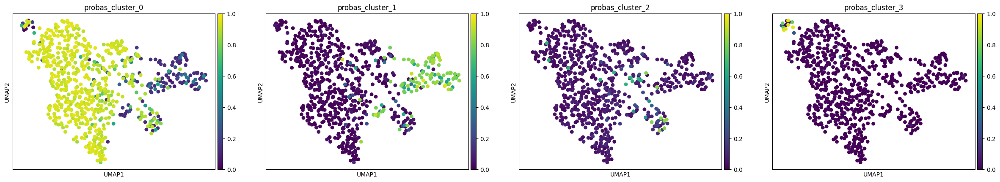

In [109]:
sc.pl.umap(human_V1, color = ['probas_cluster_0', 'probas_cluster_1', 'probas_cluster_2', 'probas_cluster_3'], vmin= 0, vmax=1)